# Capstone 2: Data wrangling (and some EDA)

## Imports

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
import os
import pandas_profiling

from library.sb_utils import save_file

## Load The Data

In [2]:
# import the clarification efficiency data for all batches (n > 1,000)
clar_eff = pd.read_csv('./data/clar_eff_by_batch.txt')

# due to varying reasions - typos or otherwise - only selecting for those calculated efficiencies between 60 an 100%
# actually disovered this in some "pre-wrangling" while getting the SQL sorted out while extracting from the production database
clar_eff = clar_eff[clar_eff['clar_eff'] < 100]
clar_eff = clar_eff[clar_eff['clar_eff'] > 60]

# import malt recipe data
rcp_malt = pd.read_csv('./data/rcp_malt.txt')

# import all additives, such as hops, data
rcp_additives = pd.read_csv('./data/rcp_additives.txt')

In [3]:
# some basic info for the clarification data
# recording pre_run_dump_data was started at about halfway through this timespan of the dataset

print(clar_eff.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1113 entries, 0 to 1332
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   rcp_id                 1113 non-null   int64  
 1   fermenter_temperature  1096 non-null   float64
 2   cu_low                 1058 non-null   float64
 3   cu_high                1092 non-null   float64
 4   cu_setpoint            1105 non-null   float64
 5   pre_run_dump_volume    553 non-null    float64
 6   time_start             1104 non-null   object 
 7   time_end               1100 non-null   object 
 8   original_gravity       1113 non-null   float64
 9   fermenter_volume       1113 non-null   float64
 10  brite_volume           1113 non-null   float64
 11  clar_eff               1113 non-null   float64
dtypes: float64(9), int64(1), object(2)
memory usage: 113.0+ KB
None


In [4]:
# some basic info for the malt recipe data
# base_malt_pct is feature engineering based off of the maximum amount of malt as a percentage of the total malt in the recipe
print(rcp_malt.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 299 entries, 0 to 298
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   rcp_id         299 non-null    int64  
 1   max_malt       299 non-null    int64  
 2   sum_malt       299 non-null    float64
 3   base_malt_pct  299 non-null    float64
dtypes: float64(2), int64(2)
memory usage: 9.5 KB
None


In [5]:
# some basic info for the additive recipe data
# this is the sum, in lbs, of an additive type (add_type), such as hops, added at each stage of the brewhouse process (location)
# the feature engineering here is this sum per BBL of the recipe fermenter volume, which for these purposes will be constant across the
# boil kettle, whirlpool, and fermenter
# the recipe fermenter volume was just repeated for each row to calculate lbs/BBL, but it is unfortunately not available for every recipe
print(rcp_additives.info())
print(rcp_additives.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 646 entries, 0 to 645
Data columns (total 6 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   recipe_id             646 non-null    int64  
 1   add_type              646 non-null    object 
 2   sum_of_additive_type  646 non-null    float64
 3   rcp_ferm_vol          323 non-null    float64
 4   location              646 non-null    object 
 5   add_per_bbl           323 non-null    float64
dtypes: float64(3), int64(1), object(2)
memory usage: 30.4+ KB
None
   recipe_id add_type  sum_of_additive_type  rcp_ferm_vol     location  \
0         75     Hops               1201.02         104.0  Boil Kettle   
1         75     Hops                246.40         104.0    Fermenter   
2         75     Hops                 95.20         104.0    Whirlpool   
3         76     Hops                728.15         108.0  Boil Kettle   
4         76     Hops                129.40       

## Wrangle The Data

In [6]:
# this is the start of the rcp_additives pivot, which intends to put all information regarding a recipe ID into one row
# this is filtering only for hops add_type and removing those rows that have NA values for ALL three locations
rcp_additives_pivot = rcp_additives[rcp_additives['add_type']=='Hops'][['recipe_id','location','add_per_bbl']].pivot(
    index='recipe_id', columns='location', values='add_per_bbl')[['Boil Kettle','Whirlpool','Fermenter']].reset_index()
rcp_additives_pivot = rcp_additives_pivot[
    ~(rcp_additives_pivot['Boil Kettle'].isna() & rcp_additives_pivot['Whirlpool'].isna() & rcp_additives_pivot['Fermenter'].isna())]
rcp_additives_pivot.columns.name = ''

# this replaces NA values with 0 for the total hops calculations
rcp_additives_pivot = rcp_additives_pivot.fillna(value=0)
rcp_additives_pivot['Total Hops'] = rcp_additives_pivot[
    'Boil Kettle'] + rcp_additives_pivot['Whirlpool'] + rcp_additives_pivot['Fermenter']

# lost a lot of recipes with this step, bummer
print(rcp_additives_pivot)
print(rcp_additives_pivot.shape)

     recipe_id  Boil Kettle  Whirlpool  Fermenter  Total Hops
0           75    11.548269   0.915385   2.369231   14.832885
1           76     6.742129   0.179722   1.198148    8.120000
3           87     2.832110   0.478899   0.582569    3.893578
4           89     1.978261   0.118261   0.000000    2.096522
5           92     2.694340   0.160377   0.000000    2.854717
..         ...          ...        ...        ...         ...
196        417     4.233333   0.933333   1.600000    6.766667
204        425     1.328125   0.000000   0.000000    1.328125
209        432     1.624242   0.484848   0.000000    2.109091
210        434     1.000000   0.266667   0.000000    1.266667
211        435     0.062500   0.562500   1.125000    1.750000

[106 rows x 5 columns]
(106, 5)


In [7]:
# merging batch data with recipe data, doing outer joins for both merges to keep as much information as possible
clar_eff_and_malt = pd.merge(clar_eff, rcp_malt[['rcp_id','base_malt_pct']], on='rcp_id', how = 'outer')
clar_eff_and_malt_and_hops = pd.merge(clar_eff_and_malt, rcp_additives_pivot, left_on='rcp_id', right_on='recipe_id', how = 'outer')[['rcp_id','base_malt_pct','Boil Kettle','Whirlpool','Fermenter','Total Hops','fermenter_temperature','cu_low','cu_high','cu_setpoint','pre_run_dump_volume','original_gravity','clar_eff']]
clar_eff_and_malt_and_hops['rcp_id'] = clar_eff_and_malt_and_hops['rcp_id'].astype('str')

# but removing rows without the target feature of interest
clar_eff_and_malt_and_hops = clar_eff_and_malt_and_hops[~clar_eff_and_malt_and_hops['clar_eff'].isnull()]

# save the data to a new csv file
datapath = './data'
save_file(clar_eff_and_malt_and_hops, 'batch_data_clean.csv', datapath)

# still have >1,000 records for clarified batches
print(clar_eff_and_malt_and_hops.head())
print(clar_eff_and_malt_and_hops.shape)

A file already exists with this name.

Writing file.  "./data\batch_data_clean.csv"
  rcp_id  base_malt_pct  Boil Kettle  Whirlpool  Fermenter  Total Hops  \
0    102      79.104477     7.944444   0.435185   1.196296    9.575926   
1    102      79.104477     7.944444   0.435185   1.196296    9.575926   
2    102      79.104477     7.944444   0.435185   1.196296    9.575926   
3    102      79.104477     7.944444   0.435185   1.196296    9.575926   
4    102      79.104477     7.944444   0.435185   1.196296    9.575926   

   fermenter_temperature  cu_low  cu_high  cu_setpoint  pre_run_dump_volume  \
0                   33.0    0.40     0.70          0.4                  NaN   
1                   33.0    0.40     0.70          0.4                  NaN   
2                   36.0    0.15     0.25          0.4                  NaN   
3                   36.0    0.30     0.80          0.8                  NaN   
4                   33.2    0.24     0.80          8.0                  NaN 

In [8]:
# merging recipe information with their respective medians
# median was chosen due to some lack of normal distribtions in the data
rcp_malt_and_hops = pd.merge(
    rcp_malt[['rcp_id','base_malt_pct']], rcp_additives_pivot, left_on = 'rcp_id', right_on = 'recipe_id', how = 'outer')
rcp_malt_and_hops_median_all = pd.merge(rcp_malt_and_hops, clar_eff.groupby('rcp_id')[
    ['fermenter_temperature','cu_low','cu_high','cu_setpoint','pre_run_dump_volume','original_gravity','clar_eff']
    ].median().reset_index(), on = 'rcp_id', how = 'outer')[
        ['rcp_id','base_malt_pct','Boil Kettle','Whirlpool','Fermenter','Total Hops','fermenter_temperature',
        'cu_low','cu_high','cu_setpoint','pre_run_dump_volume','original_gravity','clar_eff']]
rcp_malt_and_hops_median_all = rcp_malt_and_hops_median_all[~rcp_malt_and_hops_median_all['clar_eff'].isnull()]

# save the data to a new csv file
datapath = './data'
save_file(rcp_malt_and_hops_median_all, 'recipe_data_clean.csv', datapath)

print(rcp_malt_and_hops_median_all.head())
print(rcp_malt_and_hops_median_all.shape)

A file already exists with this name.

Writing file.  "./data\recipe_data_clean.csv"
   rcp_id  base_malt_pct  Boil Kettle  Whirlpool  Fermenter  Total Hops  \
0      75      81.935483    11.548269   0.915385   2.369231   14.832885   
1      76      73.452258     6.742129   0.179722   1.198148    8.120000   
2      78      86.021507          NaN        NaN        NaN         NaN   
3      87      67.502022     2.832110   0.478899   0.582569    3.893578   
4      89      70.038909     1.978261   0.118261   0.000000    2.096522   

   fermenter_temperature  cu_low  cu_high  cu_setpoint  pre_run_dump_volume  \
0                   34.0   0.120    0.350         0.60                 1.20   
1                   33.6   0.170    0.400         0.70                 1.05   
2                   33.0   0.215    0.425         0.60                  NaN   
3                   33.0   0.130    0.330         0.40                10.20   
4                   39.0   0.240    0.400         0.55               

## Explore The Data

In [9]:
# Pandas profiling report for batch data
# A big takeaway is the effect of core brands dominating the batch data - the top brand makes up over 22% of the batch data
# This shows itself in the recipe data distributions, such as the base_malt_pct, hop amounts, and original_gravity
clar_eff_and_malt_and_hops.profile_report(sort='None', html={'style':{'full_width': True}}, progress_bar=False)

In [10]:
# Pandas profiling report for recipe data
# Unfortunately far less data - may not be too useful for a machine learning application
rcp_malt_and_hops_median_all.profile_report(sort='None', html={'style':{'full_width': True}}, progress_bar=False)

### Number Of Missing Values By Column

In [11]:
# Missing value counts
# As mentioned above, recording pre-run dump volumes didn't start until about halfway through this period
# A lot of hop data missing - this is due to a lot of recipes being brewed on the smaller pilot system,
# which is much more manual and doesn't require hop values to be recorded in the production database
missing = pd.concat([clar_eff_and_malt_and_hops.isnull().sum(), 100 * clar_eff_and_malt_and_hops.isnull().mean()], axis=1)
missing.columns=['count', '%']
missing.sort_values(by='%',ascending=False)

,count,%
pre_run_dump_volume,560,50.314465
Boil Kettle,288,25.876011
Whirlpool,288,25.876011
Fermenter,288,25.876011
Total Hops,288,25.876011
cu_low,55,4.941599
cu_high,21,1.886792
fermenter_temperature,17,1.527403
cu_setpoint,8,0.718778
base_malt_pct,1,0.089847


In [12]:
# Missing value counts
missing = pd.concat([rcp_malt_and_hops_median_all.isnull().sum(), 100 * rcp_malt_and_hops_median_all.isnull().mean()], axis=1)
missing.columns=['count', '%']
missing.sort_values(by='%',ascending=False)

,count,%
Boil Kettle,170,63.197026
Whirlpool,170,63.197026
Fermenter,170,63.197026
Total Hops,170,63.197026
pre_run_dump_volume,113,42.007435
cu_low,10,3.717472
cu_high,7,2.602230
cu_setpoint,6,2.230483
fermenter_temperature,3,1.115242
base_malt_pct,1,0.371747


 ## Review distributions

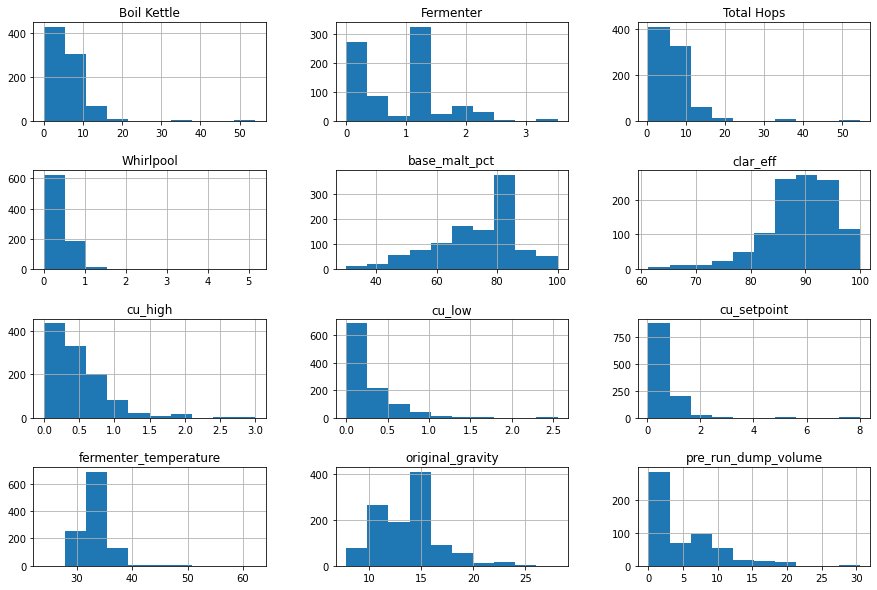

In [13]:
# This can be seen in the pandas profiling above, but it's nice to see them all together as well
# Distributions for the batch data
clar_eff_and_malt_and_hops.hist(figsize=(15,10))
plt.subplots_adjust(hspace=0.5)

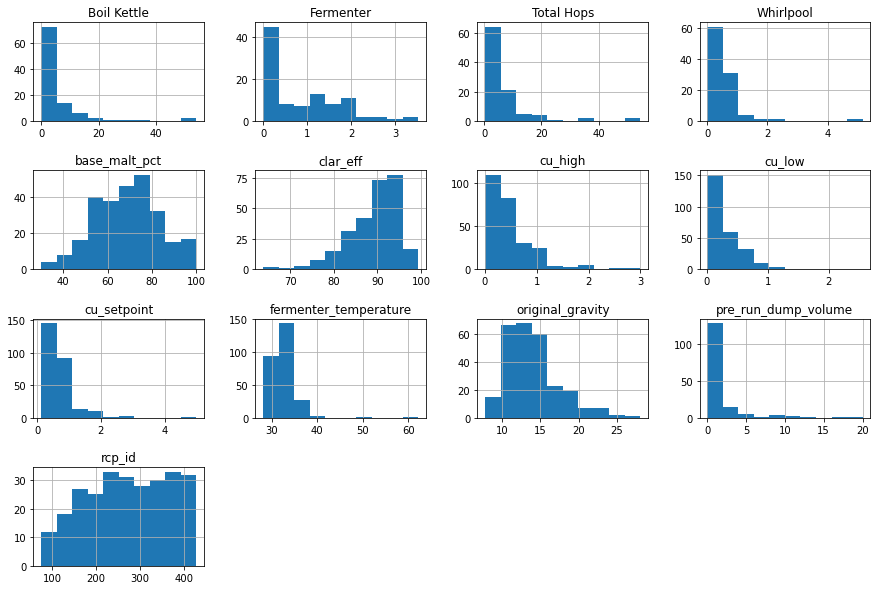

In [14]:
# districutions for the recipe data
rcp_malt_and_hops_median_all.hist(figsize=(15,10))
plt.subplots_adjust(hspace=0.5)

## Target Feature

In [15]:
# evaluating clarification efficinecies via box plot on the batch data
# filtering for only those recipes that have been run more than 5 times
multi_values = clar_eff_and_malt_and_hops['rcp_id'].value_counts() > 5
multi_values_true = pd.DataFrame(multi_values[multi_values == True])
multi_values_true = multi_values_true.reset_index(drop=False)
box_data = clar_eff_and_malt_and_hops.merge(multi_values_true, left_on='rcp_id', right_on='index')

# categorizing total hop lbs/BBL into rough quartiles for color coding
box_data['Hop Categories'] = pd.cut(box_data['Total Hops'],bins=[0,2,6,10,60],labels=['0 - 2 lbs/BBL','2 - 6 lbs/BBL','6-10 lbs/BBL','>10 lbs/BBL'])
box_data.head()

,rcp_id_x,base_malt_pct,Boil Kettle,Whirlpool,Fermenter,Total Hops,fermenter_temperature,cu_low,cu_high,cu_setpoint,pre_run_dump_volume,original_gravity,clar_eff,index,rcp_id_y,Hop Categories
0,102,79.104477,7.944444,0.435185,1.196296,9.575926,33.0,0.40,0.70,0.4,NaN,14.38,90.209426,102,True,6-10 lbs/BBL
1,102,79.104477,7.944444,0.435185,1.196296,9.575926,33.0,0.40,0.70,0.4,NaN,14.38,90.209426,102,True,6-10 lbs/BBL
2,102,79.104477,7.944444,0.435185,1.196296,9.575926,36.0,0.15,0.25,0.4,NaN,14.55,87.540528,102,True,6-10 lbs/BBL
3,102,79.104477,7.944444,0.435185,1.196296,9.575926,36.0,0.30,0.80,0.8,NaN,14.38,86.248203,102,True,6-10 lbs/BBL
4,102,79.104477,7.944444,0.435185,1.196296,9.575926,33.2,0.24,0.80,8.0,NaN,14.30,89.827430,102,True,6-10 lbs/BBL


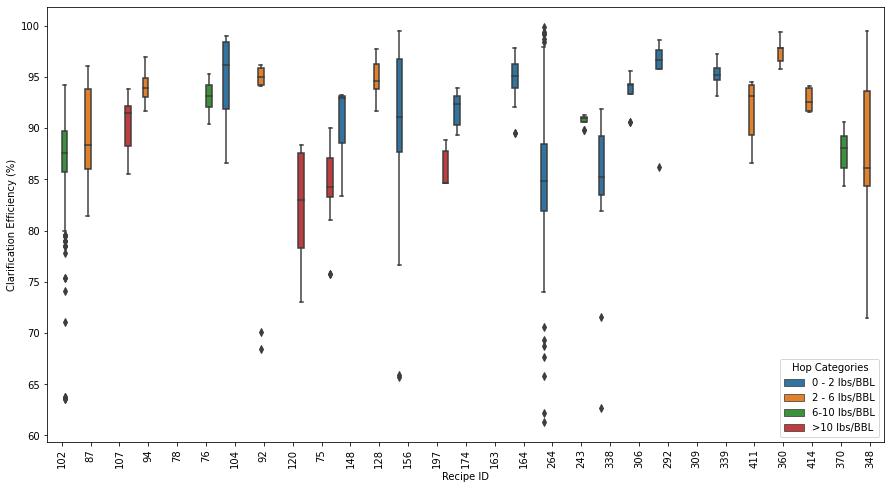

In [16]:
# plot the filtered batch data
# it seems the heavy hop loads are in the sub-90% clarification efficiency range...
# some low hop loads are higher efficiency, but some have a lot of variance as well
plt.subplots(figsize=(15, 8))
sns.boxplot(x='rcp_id_x', y='clar_eff', hue = 'Hop Categories', data=box_data)
plt.xticks(rotation='vertical')
plt.ylabel('Clarification Efficiency (%)')
plt.xlabel('Recipe ID');

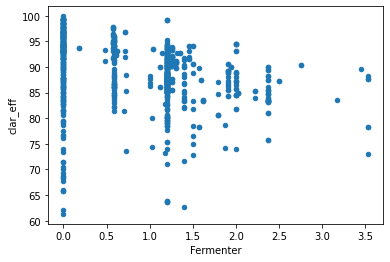

In [17]:
# Just a quick scatter plot of the clarification efficiency vs fermenter hops (also known as the "dry hops") 
clar_eff_and_malt_and_hops.plot(x='Fermenter', y='clar_eff', kind='scatter');

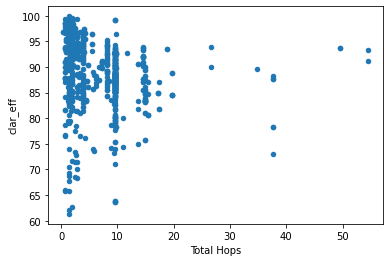

In [18]:
# Another quick scatter plot of clarification efficiency vs total hops
clar_eff_and_malt_and_hops.plot(x='Total Hops', y='clar_eff', kind='scatter');

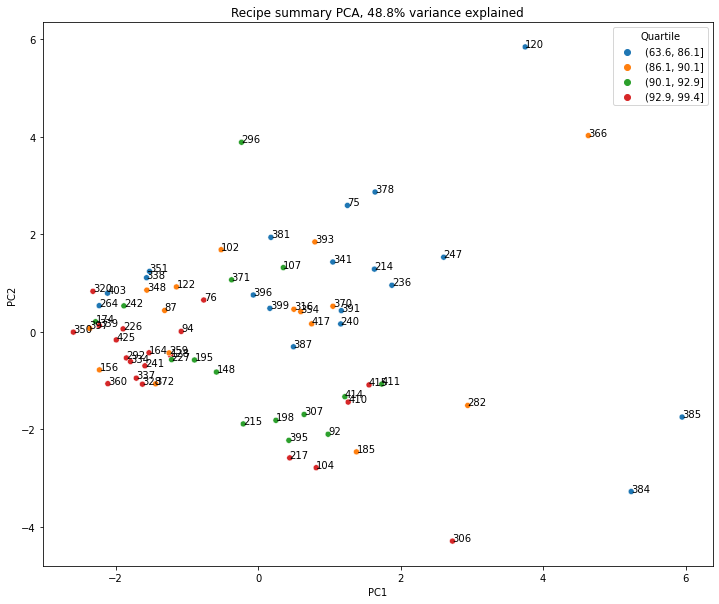

In [19]:
# A "quick" PCA with clarification efficiencies color coded by quartile
# There does seem to be some grouping, but like the box plot above plenty of
# overlap among quartiles and in-group variance.
# Also, less than half the variance is explained by the dataset...

batch_data = pd.read_csv('./data/batch_data_clean.csv')
recipe_data = pd.read_csv('./data/recipe_data_clean.csv')

recipe_data_scale = recipe_data.dropna().set_index('rcp_id')
recipe_data_index = recipe_data_scale.index
recipe_data_columns = recipe_data_scale.columns
recipe_data_scale = scale(recipe_data.dropna())

recipe_scaled_df = pd.DataFrame(recipe_data_scale, columns=recipe_data.columns)

recipe_pca = PCA().fit(recipe_data_scale)
recipe_pca_x = recipe_pca.transform(recipe_data_scale)
pc_var = 100 * recipe_pca.explained_variance_ratio_.cumsum()[1]

recipe_avg_eff = batch_data.groupby('rcp_id')['clar_eff'].mean()
pca_df = pd.DataFrame({'PC1': recipe_pca_x[:, 0], 'PC2':recipe_pca_x[:, 1]}, index=recipe_data_index)

pca_df = pd.concat([pca_df, recipe_avg_eff], axis=1)
pca_df['Quartile'] = pd.qcut(pca_df.clar_eff, q=4, precision=1)
pca_df = pca_df.dropna()

x = pca_df.PC1
y = pca_df.PC2
recipe = pca_df.index
plt.subplots(figsize=(12, 10))
# Note the argument below to make sure we get the colours in the ascending
# order we intuitively expect!
sns.scatterplot(x=x, y=y, hue='Quartile', 
                hue_order=pca_df.Quartile.cat.categories, data=pca_df)
for s, x, y in zip(recipe, x, y):
    plt.annotate(s, (x, y))   
plt.title(f'Recipe summary PCA, {pc_var:.1f}% variance explained');